In [2]:
%matplotlib notebook
from pathlib import Path
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np
from celluloid import Camera
from IPython.display import HTML

## Inspection:
We inspected some sample data

We do not need to preprocess this dataset as the necessary steps are directly performed by torchio during training

In [10]:
BASE = Path("E:/DoNotTouch/projects/LANSCLC/CIS_5810/selected_150_split")

images = list((BASE / "train" / "image").rglob("*.nii.gz"))
labels = list((BASE / "train" / "label_gtvp").rglob("*.nii.gz"))

We start with a helper function which automatically replaces "imagesTr" with "labelsTr" in the filepaths so that we can easily switch between CT images and label masks

In [11]:
from pathlib import Path
import re

def change_img_to_label_path(img_path: Path) -> Path:
    img_path = Path(img_path)
    # swap .../image/... -> .../label_gtvp/...
    label_dir = img_path.parent.parent / "label_gtvp"
    # remove only the FINAL "_0000" before extension
    new_name = re.sub(r'_0000(?=\.nii(\.gz)?$)', '', img_path.name)
    return label_dir / new_name

In [12]:
# images: List[Path]
candidates = [p for p in images if p.name.startswith("Lung")]
if len(candidates) < 3:
    raise IndexError(f"Only {len(candidates)} files match 'Lung*'")
sample_path = candidates[2]   # 3rd match
sample_path_label = change_img_to_label_path(sample_path)

Load NIfTI and extract image data

In [13]:
data = nib.load(sample_path)
label = nib.load(sample_path_label)

ct = data.get_fdata()
mask = label.get_fdata().astype(int)  # Class labels should not be handled as float64

In [14]:
nib.aff2axcodes(data.affine)

('L', 'P', 'S')

In [21]:
import numpy as np

def reorient2d(slice2d: np.ndarray) -> np.ndarray:
    """Flip vertically, then rotate -90° (clockwise)."""
    s = np.flipud(slice2d)
    s = np.rot90(s, k=3)
    return s

def reorient_vol(vol: np.ndarray) -> np.ndarray:
    """Apply the same 2D reorient to every axial slice of a (H,W,D) volume."""
    # flip along H (axis 0), then rotate -90° in (H,W) plane
    return np.rot90(np.flip(vol, axis=0), k=3, axes=(0, 1))

<IPython.core.display.Javascript object>


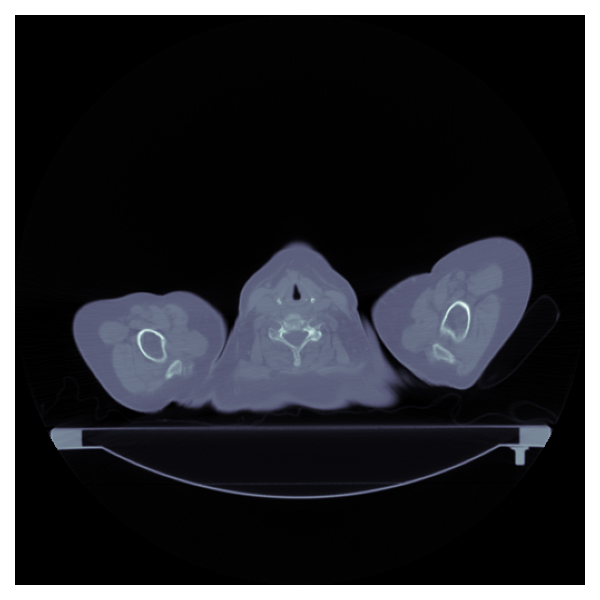

In [22]:
import matplotlib.pyplot as plt
from celluloid import Camera

ct_r   = reorient_vol(ct.astype(np.float32, copy=False))
mask_r = reorient_vol(mask).astype(bool, copy=False)  # keep mask boolean

fig, ax = plt.subplots(figsize=(6,6))
camera = Camera(fig)

for i in range(ct_r.shape[2]):          # axial
    ax.imshow(ct_r[:, :, i], cmap="bone", origin="upper")
    overlay = np.ma.masked_where(~mask_r[:, :, i], mask_r[:, :, i])
    ax.imshow(overlay, alpha=0.5, cmap="autumn", origin="upper")
    ax.set_axis_off()
    camera.snap()

plt.tight_layout()
animation = camera.animate(interval=80)  # ~12.5 fps
# from IPython.display import HTML; HTML(animation.to_jshtml())     # show inline
# animation.save("ct_mask.gif", writer="pillow", fps=12)            # or save

In [24]:
from IPython.display import HTML
# one-liner swap:
HTML(animation.to_jshtml())   # instead of animation.to_html5_video()

Animation size has reached 21003559 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
